In [1]:
import geopandas as gpd
import xarray as xr

import sys
sys.path.append('C:/Users/mbonney/OneDrive - NRCan RNCan/Projects/UtilityCode/DataAccess/Utilities')
sys.path.append('C:/Users/mbonney/OneDrive - NRCan RNCan/Projects/UtilityCode/Visualization/Utilities')

import STAC_Utils as sutil
import PreProcess_Utils as pputil
import Viz_Utils as vutil

# Create local dask client
- Allows for efficient parallalization on local machine
- Straightforward to deploy to cluster

In [2]:
from dask.distributed import LocalCluster

cluster = LocalCluster(n_workers = 10, threads_per_worker = 10) # Refined through testing
client = cluster.get_client()
client # Can open in other window by clicking 'Dashboard' link below

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 10
Total threads: 100,Total memory: 127.65 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:52043,Workers: 10
Dashboard: http://127.0.0.1:8787/status,Total threads: 100
Started: Just now,Total memory: 127.65 GiB
Comm: tcp://127.0.0.1:52091,Total threads: 10
Dashboard: http://127.0.0.1:52106/status,Memory: 12.77 GiB
Nanny: tcp://127.0.0.1:52046,


2024-04-30 14:58:49,903 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,919 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,928 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,937 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,947 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,959 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,977 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:49,989 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:50,000 - distributed.nanny - WARNING - Restarting worker
2024-04-30 14:58:50,015 - distributed.nanny - WARNING - Restarting worker


# Select area
- GeoDataFrame (could also be path the shp)

<Axes: >

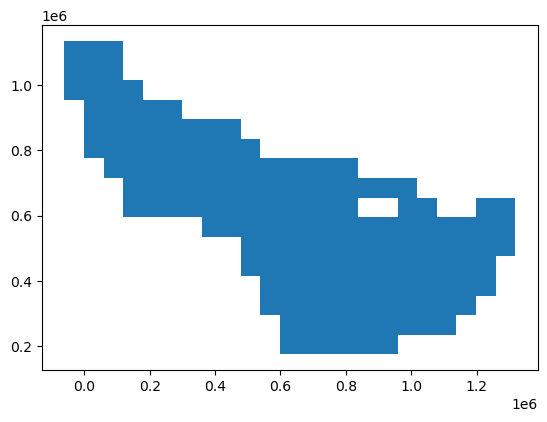

In [3]:
tiles = gpd.read_file('C:/Users/mbonney/OneDrive - NRCan RNCan/Projects/HBL/Tiling/TileSystems/60km/canadaFishnet_60km_HBL.shp')
tiles.plot()

In [4]:
selected = tiles[(tiles['FID_1'] == 960)]
selected

,FID_1,geometry
106,960,"POLYGON ((658705.079 655715.838, 658705.079 71..."


# Other parameters
- Can adjust values (e.g., shorten time range) to get results faster and use less memory

In [5]:
start = '2022-08-01' #'2022-08-01' # Earliest date in cube
end = '2023-07-31' # Latest date in cube
bands = ['BLUE', 'GREEN', 'RED', 'NIR', 'SWIR1', 'SWIR2', 'Fmask'] # Bands in cube
thresh = 90 # For filtering (remove scenes with cloud metadata above this, remove cube timesteps with local cloud cover above this)

# Generate  dask-backed HLS cubes (buildHLS)
1. Create bounding boxes (lat/lon for STAC search, UTM or area projection for stackstac)
2. Configure GDAL to access COGs from EarthData
3. Open LPCLOUD catalog
4. Get all L30 and S30 items in catalog (as long json) - Note: L30 and S30 are processed seperately from here (find ALL unique observations)
5. For spectral bands and Fmask band, create smallest dtype, chunked, resampled/reprojected L30/S30 cubes with stackstac as dask-backed xarrays
6. For all cubes, remove time-steps with NaT times and with cloud cover metadata > thresh
7. For all cubes, remove duplicate (i.e., same-day) observations = Note: S30 and L30 same-day observations are NOT considered duplicates
8. Merge L30 and S30 into dask-backed HLS cube (for spectral and Fmask)   

In [6]:
%%time
hlss, hlsm = sutil.buildHLS(selected, # Area to build cube
                            start, # Start date of cube
                            end,  # End date of cube
                            bands, # Bands in cube
                            thresh, # Filtering cube by cloud cover
                            proj = 'poly', # How to project cube
                            verbose = True) # Print function outputs
# See buildHLS() in STAC_Utils
# See poly2bbox() in PreProcess_Utils
# See bandBuilder() in PreProcess_Utils
# See removeBadScenes() in PreProcess_Utils
# See sameDayMerge() in PreProcess_Utils

Bounding boxes created and projection defined (EPSG:3979).
Connected to NASA Earthdata (LPCLOUD).
L30 images found on NASA EarthData (n = 288).
S30 images found on NASA EarthData (n = 331).
...Building L30 spectral cube...
Removed images with NaT times (n = 287).
Removed images above 90% scene-level clouds (n = 228).
Same-day time-steps merged (n = 79).
...Building L30 Fmask cube...
Removed images with NaT times (n = 287).
Removed images above 90% scene-level clouds (n = 228).
Same-day time-steps merged (n = 79).
...Building S30 spectral cube...
Removed images with NaT times (n = 331).
Removed images above 90% scene-level clouds (n = 262).
Same-day time-steps merged (n = 95).
...Building S30 Fmask cube...
Removed images with NaT times (n = 331).
Removed images above 90% scene-level clouds (n = 262).
Same-day time-steps merged (n = 95).
Combined L30 and S30 into HLS spectral cube (n = 174).
Combined L30 and S30 into HLS Fmask cube (n = 174).
CPU times: total: 12.6 s
Wall time: 24.7 s


*This is pretty quick because we have not done any real processing yet, we have just generated the 'dask graph' that the computer will follow when we want to initiate processing.*

In [7]:
hlss

<xarray.DataArray 'stackstac-878028cc9f07b9c3f6107f4122e4260f' (time: 174,
                                                                band: 6,
                                                                y: 2001, x: 2001)> Size: 8GB
dask.array<getitem, shape=(174, 6, 2001, 2001), dtype=int16, chunksize=(1, 6, 2001, 2001), chunktype=numpy.ndarray>
Coordinates:
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 2kB 'S30' 'L30' 'L30' 'S30' ... 'L30' 'S30' 'L30'
  * time           (time) datetime64[ns] 1kB 2022-08-01 ... 2023-07-30
  * band           (band) <U5 120B 'BLUE' 'GREEN' 'RED' 'NIR' 'SWIR1' 'SWIR2'
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

In [8]:
hlsm

<xarray.DataArray 'stackstac-71c353ca5ce7ef0f2be13e8ba990c395' (time: 174,
                                                                band: 1,
                                                                y: 2001, x: 2001)> Size: 697MB
dask.array<getitem, shape=(174, 1, 2001, 2001), dtype=uint8, chunksize=(1, 1, 2001, 2001), chunktype=numpy.ndarray>
Coordinates:
  * band           (band) <U5 20B 'Fmask'
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 2kB 'S30' 'L30' 'L30' 'S30' ... 'L30' 'S30' 'L30'
  * time           (time) datetime64[ns] 1kB 2022-08-01 ... 2023-07-30
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

## Digging deeper...

In [9]:
import pystac_client as pc
import stackstac as ss

import os
from rasterio.enums import Resampling

In [10]:
bboxLL = pputil.poly2bbox(selected, 'lat/lon') # For STAC search
print(bboxLL)
bbox, epsg = pputil.poly2bbox(selected, 'poly') # For stackstac
print(bbox)
print(epsg)

(-84.61482699194339, 54.36720099866807, -83.51924103422587, 55.00192938128256)
(658705.0793625484, 655715.8378995443, 718705.0793625484, 715715.8378995443)
3979


In [11]:
gdalEnv = ss.DEFAULT_GDAL_ENV.updated(dict(
    GDAL_DISABLE_READDIR_ON_OPEN = 'TRUE',
    GDAL_HTTP_COOKIEFILE = os.path.expanduser('~/cookies.txt'),
    GDAL_HTTP_COOKIEJAR = os.path.expanduser('~/cookies.txt'),
    GDAL_HTTP_MAX_RETRY = 10,
    GDAL_HTTP_RETRY_DELAY = 15))

In [12]:
cat = pc.Client.open('https://cmr.earthdata.nasa.gov/stac/LPCLOUD')
cat

<Client id=LPCLOUD>

In [13]:
itemsL30 = cat.search(bbox = bboxLL, 
                      datetime = f'{start}/{end}',
                      collections = ['HLSL30.v2.0'],
                      limit = 100).item_collection() # Max value is 250, faster than default (but lead to some gateway errors so set to 100)
itemsL30

In [14]:
bandsL30, bandsS30 = pputil.bandBuilder(bands, 'hls')
bandsL30

['B02', 'B03', 'B04', 'B05', 'B06', 'B07']

In [15]:
l30s = ss.stack(itemsL30, 
                assets = bandsL30, 
                epsg = epsg, 
                resolution = 30, 
                bounds = bbox, 
                resampling = Resampling.cubic, # continuous
                chunksize = (1, -1, -1, -1), # 1 time-step, all bands, full exten
                xy_coords = 'center', # Coordinates are for each pixel's centroid (xarray convention)
                dtype = 'int16', # Reduces size to 25% of default (float64)
                fill_value = -9999,
                rescale = False, 
                gdal_env = gdalEnv)
l30s

C:\Users\mbonney\Miniforge3\envs\rs3\Lib\site-packages\stackstac\prepare.py:408: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  times = pd.to_datetime(


<xarray.DataArray 'stackstac-94f4cc61ce2d661f82babf551a904bde' (time: 287,
                                                                band: 6,
                                                                y: 2001, x: 2001)> Size: 14GB
dask.array<fetch_raster_window, shape=(287, 6, 2001, 2001), dtype=int16, chunksize=(1, 6, 2001, 2001), chunktype=numpy.ndarray>
Coordinates:
  * time            (time) datetime64[ns] 2kB 2022-08-02T16:43:33.738000 ... ...
    id              (time) <U34 39kB 'HLS.L30.T16UFG.2022214T164333.v2.0' ......
  * band            (band) <U3 72B 'B02' 'B03' 'B04' 'B05' 'B06' 'B07'
  * x               (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y               (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    eo:cloud_cover  (time) int32 1kB 34 52 99 100 100 100 ... 17 84 73 47 58 76
    start_datetime  (time) <U24 28kB '2022-08-02T16:43:33.738Z' ... '2023-07-...
    end_datetime    (time) <U24 28kB '2022-08-02T16:43:57.616Z' ... '2023-07-...
    epsg            int32 4B 3979
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

In [16]:
#l30s.time.values

# Process cloud mask cube
1. Load into memory (required for some internal operations like numpy bitwise and suming values in each time-step) - Dask graph applied
2. Convert Fmask bit-packed values to binary mask (1 = clear, 0 = unclear)

In [17]:
%%time
hlsm = pputil.loadXR(hlsm)
# See loadXR() in PreProcess_Utils
hlsm

CPU times: total: 32.9 s
Wall time: 1min 45s


<xarray.DataArray 'stackstac-71c353ca5ce7ef0f2be13e8ba990c395' (time: 174,
                                                                band: 1,
                                                                y: 2001, x: 2001)> Size: 697MB
array([[[[200, 200, 200, ...,  66,  66, 130],
         [200, 200, 200, ...,  66,  66, 130],
         [200, 200, 200, ...,  66,  66, 130],
         ...,
         [194, 194, 194, ..., 194, 194, 194],
         [194, 194, 194, ..., 194, 194, 194],
         [198, 194, 194, ..., 194, 194, 194]]],


       [[[255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         ...,
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255],
         [255, 255, 255, ..., 255, 255, 255]]],


       [[[192, 192, 192, ..., 255, 255, 255],
         [192, 192, 192, ..., 200, 200, 200],
...
         [194, 194, 194, ..., 194, 194, 194],
         [194, 194, 194, ..., 194, 194, 194]]],


       [[[194, 194, 194, ...,  66,  66,  66],
         [194, 194, 194, ...,  66,  66,  66],
         [194, 194, 194, ..., 130, 130,  66],
         ...,
         [194, 194, 194, ..., 196, 196, 192],
         [194, 194, 194, ..., 196, 196, 192],
         [194, 194, 194, ..., 196, 196, 196]]],


       [[[255, 255, 255, ...,  68,  68,  68],
         [255, 255, 255, ...,  68,  68,  68],
         [255, 255, 255, ...,  68,  68,  68],
         ...,
         [ 68,  68,  68, ..., 194, 194, 194],
         [ 68,  68,  68, ..., 194, 194, 194],
         [ 68,  68,  68, ..., 194, 194, 194]]]], dtype=uint8)
Coordinates:
  * band           (band) <U5 20B 'Fmask'
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 2kB 'S30' 'L30' 'L30' 'S30' ... 'L30' 'S30' 'L30'
  * time           (time) datetime64[ns] 1kB 2022-08-01 ... 2023-07-30
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

In [18]:
%%time
hlsm = pputil.convertFmask(hlsm, # Mask cube to convert
                           format = 'clearUnclear', # 1 = clear, 0 = unclear
                           consideredClear = ['land', 'water', 'snow', 'aerosol_land', 'aerosol_water', 'aerosol_snow'])
#hlsm = xr.apply_ufunc(pputil.convertFmask, hlsm, dask = 'parallelized', kwargs = {'format': 'clearUnclear', 'snowClear': True}) # Testing
# See convertFmask() in PreProcess_Utils()
hlsm

CPU times: total: 7.88 s
Wall time: 6.32 s


<xarray.DataArray 'stackstac-71c353ca5ce7ef0f2be13e8ba990c395' (time: 174,
                                                                band: 1,
                                                                y: 2001, x: 2001)> Size: 697MB
array([[[[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]],


       [[[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]],


       [[[ True,  True,  True, ..., False, False, False],
         [ True,  True,  True, ..., False, False, False],
...
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]],


       [[[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False,  True],
         [False, False, False, ..., False, False,  True],
         [False, False, False, ..., False, False, False]]],


       [[[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]]])
Coordinates:
  * band           (band) <U5 20B 'Fmask'
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 2kB 'S30' 'L30' 'L30' 'S30' ... 'L30' 'S30' 'L30'
  * time           (time) datetime64[ns] 1kB 2022-08-01 ... 2023-07-30
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

# Process spectral cube
1. Remove time-steps with high local cloud cover based on Fmask
2. Rescale and mask fill values
3. Load into memory (required for some internal operations like pixel masking) - Dask graph applied
4. Mask pixels classified as cloudy by Fmask

In [19]:
%%time
hlss, hlsm = pputil.timestepClean(hlss, 
                                  hlsm, 
                                  timestepClean = 'unclear', 
                                  thresh = thresh, 
                                  cleanMask = True, 
                                  verbose = True)
# See timestepClean() in PreProcess_Utils()

Removed time-steps above 90% unclear pixels (n = 99).
CPU times: total: 1.69 s
Wall time: 1.36 s


In [20]:
hlss

<xarray.DataArray 'stackstac-878028cc9f07b9c3f6107f4122e4260f' (time: 99,
                                                                band: 6,
                                                                y: 2001, x: 2001)> Size: 5GB
dask.array<getitem, shape=(99, 6, 2001, 2001), dtype=int16, chunksize=(1, 6, 2001, 2001), chunktype=numpy.ndarray>
Coordinates:
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 1kB 'S30' 'L30' 'S30' 'L30' ... 'S30' 'S30' 'L30'
  * time           (time) datetime64[ns] 792B 2022-08-08 ... 2023-07-30
  * band           (band) <U5 120B 'BLUE' 'GREEN' 'RED' 'NIR' 'SWIR1' 'SWIR2'
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

In [21]:
hlsm

<xarray.DataArray 'stackstac-71c353ca5ce7ef0f2be13e8ba990c395' (time: 99,
                                                                band: 1,
                                                                y: 2001, x: 2001)> Size: 396MB
array([[[[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]],


       [[[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True]]],


       [[[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
...
         [False, False, False, ...,  True,  True,  True],
         [False, False, False, ...,  True,  True,  True]]],


       [[[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [ True,  True,  True, ..., False, False, False],
         [ True,  True,  True, ..., False, False, False],
         [ True,  True,  True, ..., False, False, False]]],


       [[[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]]])
Coordinates:
  * band           (band) <U5 20B 'Fmask'
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 1kB 'S30' 'L30' 'S30' 'L30' ... 'S30' 'S30' 'L30'
  * time           (time) datetime64[ns] 792B 2022-08-08 ... 2023-07-30
Attributes:
    spec:        RasterSpec(epsg=3979, bounds=(658680, 655710, 718710, 715740...
    crs:         epsg:3979
    transform:   | 30.00, 0.00, 658680.00|\n| 0.00,-30.00, 715740.00|\n| 0.00...
    resolution:  30

In [22]:
%%time
hlss = pputil.rescaleFill(hlss, 
                          rescale = 0.0001, 
                          fill = -9999, 
                          verbose = True)
# See rescaleFill() in PreProcess_Utils()
hlss

-9999 set to NA and other values rescaled by 0.0001.
CPU times: total: 31.2 ms
Wall time: 19.5 ms


<xarray.DataArray 'stackstac-878028cc9f07b9c3f6107f4122e4260f' (time: 99,
                                                                band: 6,
                                                                y: 2001, x: 2001)> Size: 10GB
dask.array<mul, shape=(99, 6, 2001, 2001), dtype=float32, chunksize=(1, 6, 2001, 2001), chunktype=numpy.ndarray>
Coordinates:
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 1kB 'S30' 'L30' 'S30' 'L30' ... 'S30' 'S30' 'L30'
  * time           (time) datetime64[ns] 792B 2022-08-08 ... 2023-07-30
  * band           (band) <U5 120B 'BLUE' 'GREEN' 'RED' 'NIR' 'SWIR1' 'SWIR2'

In [23]:
%%time
hlss = pputil.loadXR(hlss)
# See loadXR() in PreProcess_Utils
hlss

CPU times: total: 3min 4s
Wall time: 9min 32s


<xarray.DataArray 'stackstac-878028cc9f07b9c3f6107f4122e4260f' (time: 99,
                                                                band: 6,
                                                                y: 2001, x: 2001)> Size: 10GB
array([[[[ 2.02999990e-02,  2.45999992e-02,  2.87999995e-02, ...,
           1.69999991e-02,  1.75999999e-02,  1.84000004e-02],
         [ 1.53999999e-02,  2.15999987e-02,  3.04999985e-02, ...,
           1.63000003e-02,  1.68999992e-02,  1.80999991e-02],
         [ 1.64999999e-02,  3.15999985e-02,  2.69999988e-02, ...,
           1.57999992e-02,  1.58999991e-02,  1.65999997e-02],
         ...,
         [ 1.69999991e-03,  5.99999970e-04,  9.99999975e-05, ...,
           7.80399978e-01,  7.32699990e-01,  6.49699986e-01],
         [ 4.99999966e-04, -3.99999990e-04,  0.00000000e+00, ...,
           6.90599978e-01,  5.67399979e-01,  4.53999996e-01],
         [ 1.19999994e-03,  6.99999975e-04,  0.00000000e+00, ...,
           5.48200011e-01,  3.64999980e-01,  2.45499998e-01]],

        [[ 3.70000005e-02,  3.94000001e-02,  4.51999977e-02, ...,
           3.39000002e-02,  3.46000008e-02,  3.59999985e-02],
         [ 2.95000002e-02,  3.57999988e-02,  4.73999977e-02, ...,
           3.22999991e-02,  3.35999988e-02,  3.55999991e-02],
         [ 2.97999997e-02,  4.89999987e-02,  4.29999977e-02, ...,
           3.17000002e-02,  3.26000005e-02,  3.26000005e-02],
...
           4.74199980e-01,  5.08199990e-01,  5.44900000e-01],
         [ 2.05599993e-01,  1.92699999e-01,  1.78299993e-01, ...,
           4.78100002e-01,  5.30900002e-01,  5.71299970e-01],
         [ 2.23399997e-01,  2.08199993e-01,  1.81299999e-01, ...,
           4.67399985e-01,  5.39499998e-01,  5.84699988e-01]],

        [[            nan,             nan,             nan, ...,
           7.94999972e-02,  7.91999996e-02,  8.38999972e-02],
         [            nan,             nan,             nan, ...,
           8.19000006e-02,  7.75999948e-02,  8.02000016e-02],
         [            nan,             nan,             nan, ...,
           8.63999948e-02,  8.06999952e-02,  7.20999986e-02],
         ...,
         [ 1.10099994e-01,  1.03499994e-01,  9.75999981e-02, ...,
           3.64799976e-01,  3.92299980e-01,  4.21799988e-01],
         [ 1.13199994e-01,  1.05999999e-01,  9.87999961e-02, ...,
           3.62100005e-01,  4.09599990e-01,  4.44499999e-01],
         [ 1.24799997e-01,  1.13699995e-01,  9.99999940e-02, ...,
           3.47999990e-01,  4.12499994e-01,  4.55199987e-01]]]],
      dtype=float32)
Coordinates:
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 1kB 'S30' 'L30' 'S30' 'L30' ... 'S30' 'S30' 'L30'
  * time           (time) datetime64[ns] 792B 2022-08-08 ... 2023-07-30
  * band           (band) <U5 120B 'BLUE' 'GREEN' 'RED' 'NIR' 'SWIR1' 'SWIR2'

In [24]:
%%time
hlss = pputil.pixelClean(hlss, 
                         hlsm, 
                         reverseMask = False,
                         verbose = True)
# See pixelClean() in PreProcess_Utils()
hlss

Unclear pixels masked.
CPU times: total: 14.2 s
Wall time: 11.8 s


<xarray.DataArray 'stackstac-878028cc9f07b9c3f6107f4122e4260f' (time: 99,
                                                                band: 6,
                                                                y: 2001, x: 2001)> Size: 10GB
array([[[[0.0203    , 0.0246    , 0.0288    , ..., 0.017     ,
          0.0176    , 0.0184    ],
         [0.0154    , 0.0216    , 0.0305    , ..., 0.0163    ,
          0.0169    , 0.0181    ],
         [0.0165    , 0.0316    , 0.027     , ..., 0.0158    ,
          0.0159    , 0.0166    ],
         ...,
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan]],

        [[0.037     , 0.0394    , 0.0452    , ..., 0.0339    ,
          0.0346    , 0.036     ],
         [0.0295    , 0.0358    , 0.0474    , ..., 0.0323    ,
          0.0336    , 0.0356    ],
         [0.0298    , 0.049     , 0.043     , ..., 0.0317    ,
          0.0326    , 0.0326    ],
...
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan]],

        [[       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         ...,
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan],
         [       nan,        nan,        nan, ...,        nan,
                 nan,        nan]]]], dtype=float32)
Coordinates:
  * x              (x) float64 16kB 6.587e+05 6.587e+05 ... 7.187e+05 7.187e+05
  * y              (y) float64 16kB 7.157e+05 7.157e+05 ... 6.558e+05 6.557e+05
    constellation  (time) <U3 1kB 'S30' 'L30' 'S30' 'L30' ... 'S30' 'S30' 'L30'
  * time           (time) datetime64[ns] 792B 2022-08-08 ... 2023-07-30
  * band           (band) <U5 120B 'BLUE' 'GREEN' 'RED' 'NIR' 'SWIR1' 'SWIR2'

# Visualize output
- Plot matrix
- Once in memory can do what you want (e.g., download to computer, run other Python processing)

CPU times: total: 3min 53s
Wall time: 3min 36s


C:\Users\mbonney\Miniforge3\envs\rs3\Lib\site-packages\matplotlib\cm.py:494: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


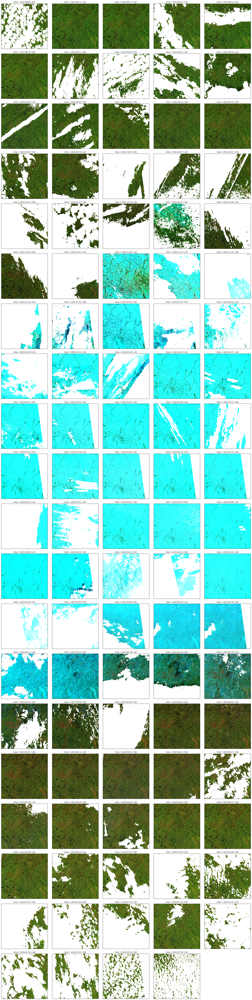

In [27]:
%%time
vutil.matrixPlot(hlss, sat = 'hls', type = 'spectral', bands = ['SWIR1', 'NIR', 'GREEN'], vmax = 0.5)
# See matrixPlot() in Viz_Utils()